# Import modules

In [12]:
import pandas as pd
import plotly.graph_objects as go

# Load data

In [2]:
data = pd.read_csv('winners.txt', names=['winner'], header=None)

# Compute win percentage

In [4]:
def rel_fraction(data):

    for row in range(data.shape[0]):
        cur = data.loc[:row, 'winner'].value_counts(normalize=True)
        data.loc[row, 'p1_win'] = float(cur.loc[1]) if 1 in cur.index else 0
        data.loc[row, 'p2_win'] = float(cur.loc[2]) if 2 in cur.index else 0
        data.loc[row, 'tie']    = float(cur.loc[0]) if 0 in cur.index else 0

    return data

In [5]:
rel_fraction(data)

,winner,p1_win,p2_win,tie
0,2,0.000000,1.000000,0.000000
1,1,0.500000,0.500000,0.000000
2,0,0.333333,0.333333,0.333333
3,0,0.250000,0.250000,0.500000
4,1,0.400000,0.200000,0.400000
...,...,...,...,...
199995,2,0.579012,0.290031,0.130958
199996,2,0.579009,0.290034,0.130957
199997,1,0.579011,0.290033,0.130956
199998,1,0.579013,0.290031,0.130956


# Plot fractions over iteration

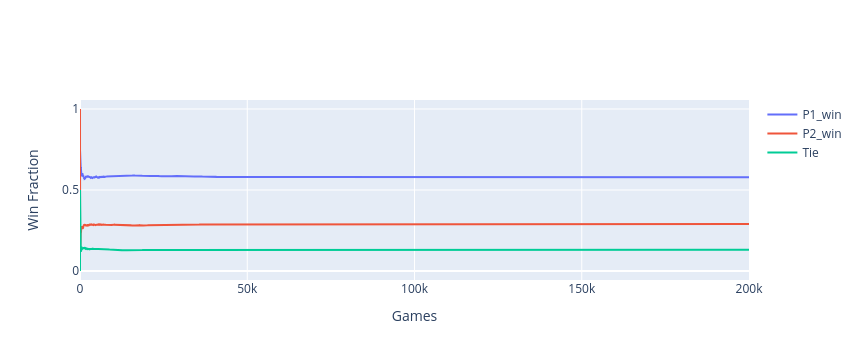

In [30]:
fig = go.Figure()

fig.add_trace(
    go.Scatter(
        x=data.index,
        y=data['p1_win'],
        name='P1_win'
    )
)

fig.add_trace(
    go.Scatter(
        x=data.index,
        y=data['p2_win'],
        name='P2_win'
    )
)

fig.add_trace(
    go.Scatter(
        x=data.index,
        y=data['tie'],
        name='Tie'
    )
)

fig.update_layout(
    xaxis_title='Games',
    yaxis_title='Win Fraction',
    # xaxis_range=[0, 1000]
)

fig.show()